C:\Users\gii2\AppData\Local\Temp\ipykernel_18172\1087707960.py:135: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  point.set_data(point_x, point_y)
Animation size has reached 21012592 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


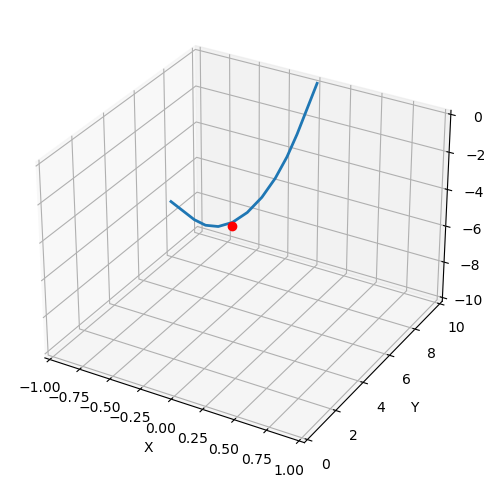

In [19]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from mpl_toolkits.mplot3d import Axes3D
from IPython.display import HTML

# Constants
g = 9.81
k = 100.0
d = 1.0
length = 1.0
mass_rope_segment = 0.1
pulley_mass = 70.0
friction_coefficient = 0.02
drag_coefficient = 0.01

# Initialization
num_points = 11
rope_positions = np.zeros((num_points, 2))
rope_velocities = np.zeros((num_points, 2))
for i in range(num_points):
    rope_positions[i] = [i * length, 0]

pulley_position = np.array([0.0, 0.0])
pulley_velocity = np.array([2.0, 0.0])

def compute_forces(positions, velocities):
    forces = np.zeros_like(positions)
    forces[:, 1] -= g * mass_rope_segment
    for i in range(1, num_points):
        delta_x = positions[i] - positions[i-1]
        delta_v = velocities[i] - velocities[i-1]
        spring_force = -k * (np.linalg.norm(delta_x) - length) * (delta_x / np.linalg.norm(delta_x))
        damping_force = -d * delta_v
        forces[i] += spring_force + damping_force
        forces[i-1] -= spring_force + damping_force
    return forces

def update_fixed(dt):
    global pulley_position, pulley_velocity, rope_positions, rope_velocities
    
    # Compute forces on rope
    forces = compute_forces(rope_positions, rope_velocities)
    
    # Update velocities and positions for rope
    rope_velocities += (forces / mass_rope_segment) * dt
    rope_positions += rope_velocities * dt
    rope_positions[0] = [0, 0]
    rope_positions[-1] = [(num_points - 1) * length, 0]
    
    # Friction and drag on pulley
    friction = -friction_coefficient * pulley_velocity
    drag = -drag_coefficient * pulley_velocity
    net_force_on_pulley = np.array([0, -pulley_mass * g]) + friction + drag
    
    # Continuous deformation based on pulley's position
    deformation_force = np.array([0, 0])
    for i in range(1, num_points):
        segment_start = rope_positions[i-1]
        segment_end = rope_positions[i]
        if segment_start[0] <= pulley_position[0] <= segment_end[0]:
            slope = (segment_end[1] - segment_start[1]) / (segment_end[0] - segment_start[0])
            intercept = segment_start[1] - slope * segment_start[0]
            rope_y_at_pulley = slope * pulley_position[0] + intercept
            if pulley_position[1] < rope_y_at_pulley:
                deformation = rope_y_at_pulley - pulley_position[1]
                deformation_force[1] = k * deformation
                pulley_position[1] = rope_y_at_pulley
    
    # Apply deformation force
    net_force_on_pulley += deformation_force
    
    # Update velocities and positions for pulley
    pulley_velocity += (net_force_on_pulley / pulley_mass) * dt
    pulley_position += pulley_velocity * dt
    
    # Constrain the pulley to stay within the rope's endpoints
    if pulley_position[0] < 0:
        pulley_position[0] = 0
        pulley_velocity[0] = 0
    elif pulley_position[0] > (num_points - 1) * length:
        pulley_position[0] = (num_points - 1) * length
        pulley_velocity[0] = 0

# Simulate
positions_over_time = [rope_positions.copy()]
pulley_positions_over_time = [pulley_position.copy()]
for _ in range(num_steps):
    update_fixed(dt)
    positions_over_time.append(rope_positions.copy())
    pulley_positions_over_time.append(pulley_position.copy())

# Convert to 3D
positions_3d = []
for positions in positions_over_time:
    new_positions = np.zeros((positions.shape[0], 3))
    new_positions[:, 0] = 0
    new_positions[:, 1] = positions[:, 0]
    new_positions[:, 2] = positions[:, 1]
    positions_3d.append(new_positions)

pulley_positions_3d = []
for pulley_position in pulley_positions_over_time:
    new_position = np.array([0, pulley_position[0], pulley_position[1]])
    pulley_positions_3d.append(new_position)

# Animation
fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot(111, projection='3d')
line, = ax.plot([], [], [], lw=2)
point, = ax.plot([], [], [], 'ro')
ax.set_xlim([-1, 1])
ax.set_ylim([0, 10])
ax.set_zlim([-10, 0])
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')

def init():
    line.set_data([], [])
    line.set_3d_properties([])
    point.set_data([], [])
    point.set_3d_properties([])
    return line, point

def animate(i):
    x_data = positions_3d[i][:, 0]
    y_data = positions_3d[i][:, 1]
    z_data = positions_3d[i][:, 2]
    line.set_data(x_data, y_data)
    line.set_3d_properties(z_data)
    point_x = pulley_positions_3d[i][0]
    point_y = pulley_positions_3d[i][1]
    point_z = pulley_positions_3d[i][2]
    point.set_data(point_x, point_y)
    point.set_3d_properties(point_z)
    return line, point

anim = FuncAnimation(fig, animate, init_func=init, frames=num_steps, interval=50, blit=True)
HTML(anim.to_jshtml())